<a href="https://colab.research.google.com/github/kkettip/diabetes_dataset/blob/main/Graphs_of_Diabetes_Dataset_Clean%2C_550_Assignment_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Install and Import Libraries

In [ ]:
!pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.5/98.5 MB 9.3 MB/s eta 0:00:00


In [ ]:
import pandas as pd   # data processing, CSV file I/O (e.g. pd.read_csv)
import numpy as np   # linear algebra
import matplotlib.pyplot as plt  #graphs and plots
import seaborn as sns   #data visualizations
import csv # Some extra functionalities for csv  files - reading it as a dictionary
from lightgbm import LGBMClassifier #sklearn is for machine learning and statistical modeling including classification, regression, clustering and dimensionality reduction

from sklearn.model_selection import train_test_split, cross_validate   #break up dataset into train and test sets

from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler


# importing python library for working with missing data
import missingno as msno
# To install missingno use: !pip install missingno
import re    # This library is used to perform regex pattern matching

# import various functions from sklearn
from sklearn.linear_model import LogisticRegression, LinearRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from catboost import CatBoostClassifier
import xgboost as xgb
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, classification_report, make_scorer
from sklearn.linear_model import SGDClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, train_test_split



In [ ]:
import plotly
import plotly.express as px
import plotly.graph_objs as go
import plotly.offline as py
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.figure_factory as ff
import warnings
warnings.filterwarnings("ignore")


#Loading csv

In [ ]:
diabetes = pd.read_csv('https://raw.githubusercontent.com/kkettip/diabetes_dataset/main/diabetic_data.csv', index_col=0)
diabetes.head(10)

,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,payer_code,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
encounter_id,,,,,,,,,,,,,,,,,,,,,
2278392,8222157,Caucasian,Female,[0-10),?,6,25,1,1,?,...,No,No,No,No,No,No,No,No,No,NO
149190,55629189,Caucasian,Female,[10-20),?,1,1,7,3,?,...,No,Up,No,No,No,No,No,Ch,Yes,>30
64410,86047875,AfricanAmerican,Female,[20-30),?,1,1,7,2,?,...,No,No,No,No,No,No,No,No,Yes,NO
500364,82442376,Caucasian,Male,[30-40),?,1,1,7,2,?,...,No,Up,No,No,No,No,No,Ch,Yes,NO
16680,42519267,Caucasian,Male,[40-50),?,1,1,7,1,?,...,No,Steady,No,No,No,No,No,Ch,Yes,NO
35754,82637451,Caucasian,Male,[50-60),?,2,1,2,3,?,...,No,Steady,No,No,No,No,No,No,Yes,>30
55842,84259809,Caucasian,Male,[60-70),?,3,1,2,4,?,...,No,Steady,No,No,No,No,No,Ch,Yes,NO
63768,114882984,Caucasian,Male,[70-80),?,1,1,7,5,?,...,No,No,No,No,No,No,No,No,Yes,>30
12522,48330783,Caucasian,Female,[80-90),?,2,1,4,13,?,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


#Clean dataset

Replacing '?' with NaN.

In [ ]:
new_df = diabetes.replace(['?'], np.nan)
new_df

,patient_nbr,race,gender,age,weight,admission_type_id,discharge_disposition_id,admission_source_id,time_in_hospital,payer_code,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
encounter_id,,,,,,,,,,,,,,,,,,,,,
2278392,8222157,Caucasian,Female,[0-10),NaN,6,25,1,1,NaN,...,No,No,No,No,No,No,No,No,No,NO
149190,55629189,Caucasian,Female,[10-20),NaN,1,1,7,3,NaN,...,No,Up,No,No,No,No,No,Ch,Yes,>30
64410,86047875,AfricanAmerican,Female,[20-30),NaN,1,1,7,2,NaN,...,No,No,No,No,No,No,No,No,Yes,NO
500364,82442376,Caucasian,Male,[30-40),NaN,1,1,7,2,NaN,...,No,Up,No,No,No,No,No,Ch,Yes,NO
16680,42519267,Caucasian,Male,[40-50),NaN,1,1,7,1,NaN,...,No,Steady,No,No,No,No,No,Ch,Yes,NO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
443847548,100162476,AfricanAmerican,Male,[70-80),NaN,1,3,7,3,MC,...,No,Down,No,No,No,No,No,Ch,Yes,>30
443847782,74694222,AfricanAmerican,Female,[80-90),NaN,1,4,5,5,MC,...,No,Steady,No,No,No,No,No,No,Yes,NO
443854148,41088789,Caucasian,Male,[70-80),NaN,1,1,7,1,MC,...,No,Down,No,No,No,No,No,Ch,Yes,NO


In [ ]:
new_df.columns

Index(['patient_nbr', 'race', 'gender', 'age', 'weight', 'admission_type_id',
       'discharge_disposition_id', 'admission_source_id', 'time_in_hospital',
       'payer_code', 'medical_specialty', 'num_lab_procedures',
       'num_procedures', 'num_medications', 'number_outpatient',
       'number_emergency', 'number_inpatient', 'diag_1', 'diag_2', 'diag_3',
       'number_diagnoses', 'max_glu_serum', 'A1Cresult', 'metformin',
       'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride',
       'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone',
       'tolazamide', 'examide', 'citoglipton', 'insulin',
       'glyburide-metformin', 'glipizide-metformin',
       'glimepiride-pioglitazone', 'metformin-rosiglitazone',
       'metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted'],
      dtype='object')

#Check for missing values.

Check columns, data types and null values.

In [ ]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101766 entries, 2278392 to 443867222
Data columns (total 49 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   patient_nbr               101766 non-null  int64 
 1   race                      99493 non-null   object
 2   gender                    101766 non-null  object
 3   age                       101766 non-null  object
 4   weight                    3197 non-null    object
 5   admission_type_id         101766 non-null  int64 
 6   discharge_disposition_id  101766 non-null  int64 
 7   admission_source_id       101766 non-null  int64 
 8   time_in_hospital          101766 non-null  int64 
 9   payer_code                61510 non-null   object
 10  medical_specialty         51817 non-null   object
 11  num_lab_procedures        101766 non-null  int64 
 12  num_procedures            101766 non-null  int64 
 13  num_medications           101766 non-null  int64 


In [ ]:
def missing (new_df):
    missing_number = new_df.isnull().sum().sort_values(ascending=False)
    missing_percent = (new_df.isnull().sum()/new_df.isnull().count()).sort_values(ascending=False)
    missing_values = pd.concat([missing_number, missing_percent], axis=1, keys=['Missing_Number', 'Missing_Percent'])
    return missing_values

missing(new_df)

,Missing_Number,Missing_Percent
weight,98569,0.968585
medical_specialty,49949,0.490822
payer_code,40256,0.395574
race,2273,0.022336
diag_3,1423,0.013983
diag_2,358,0.003518
diag_1,21,0.000206
patient_nbr,0,0.000000
troglitazone,0,0.000000
glyburide,0,0.000000


In [ ]:
#Check for amount missing
new_df.isnull().sum()

patient_nbr                     0
race                         2273
gender                          0
age                             0
weight                      98569
admission_type_id               0
discharge_disposition_id        0
admission_source_id             0
time_in_hospital                0
payer_code                  40256
medical_specialty           49949
num_lab_procedures              0
num_procedures                  0
num_medications                 0
number_outpatient               0
number_emergency                0
number_inpatient                0
diag_1                         21
diag_2                        358
diag_3                       1423
number_diagnoses                0
max_glu_serum                   0
A1Cresult                       0
metformin                       0
repaglinide                     0
nateglinide                     0
chlorpropamide                  0
glimepiride                     0
acetohexamide                   0
glipizide     

Columns with missing values are race, weight, payer_code, medical_specialty, diag_1, diag_2 and diag_3.

Visualizing the missing data

<Axes: >

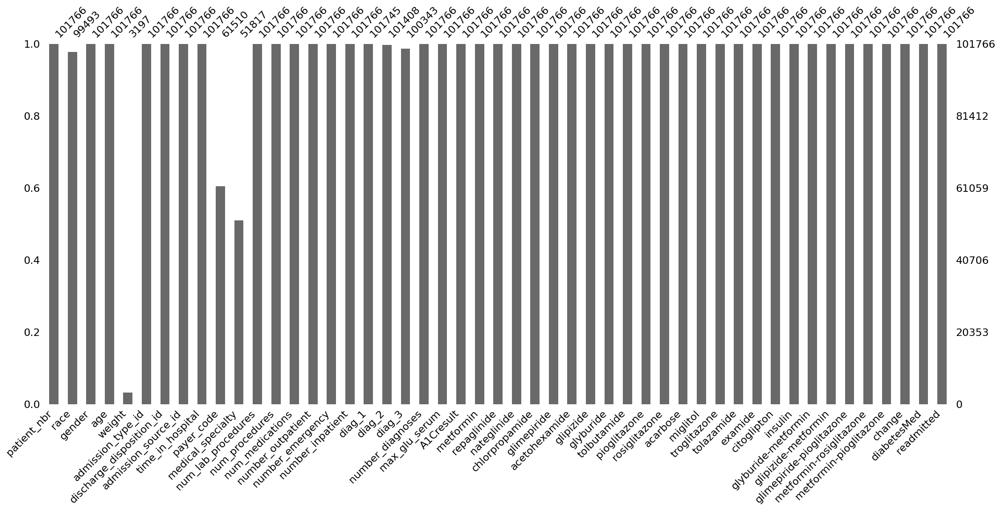

In [ ]:
# Visualizing the missing data
msno.bar(new_df)

<Axes: >

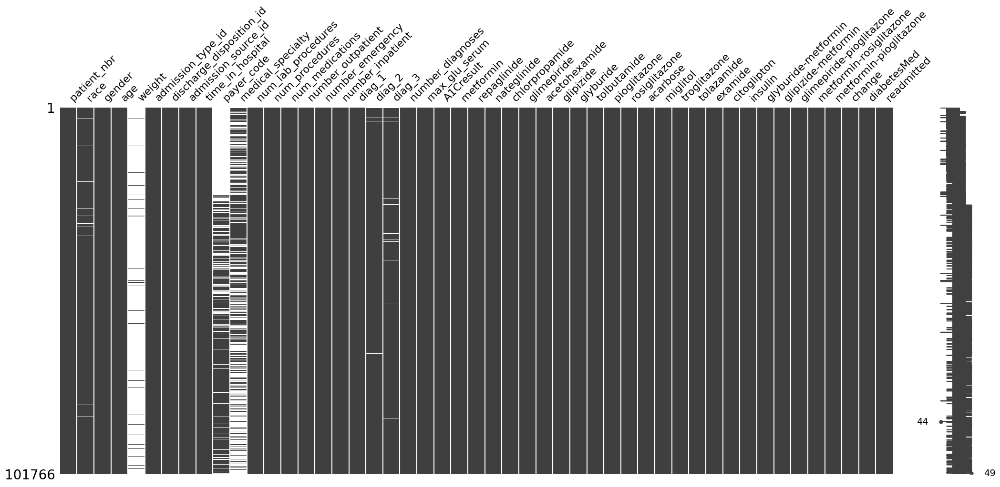

In [ ]:
msno.matrix(new_df)

#Check for duplicates.

In [ ]:
new_df.duplicated().sum()

0

There are not duplicates.

#Drop unnecessary columns.

In [ ]:
new_df.columns

Index(['patient_nbr', 'race', 'gender', 'age', 'weight', 'admission_type_id',
       'discharge_disposition_id', 'admission_source_id', 'time_in_hospital',
       'payer_code', 'medical_specialty', 'num_lab_procedures',
       'num_procedures', 'num_medications', 'number_outpatient',
       'number_emergency', 'number_inpatient', 'diag_1', 'diag_2', 'diag_3',
       'number_diagnoses', 'max_glu_serum', 'A1Cresult', 'metformin',
       'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride',
       'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide',
       'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone',
       'tolazamide', 'examide', 'citoglipton', 'insulin',
       'glyburide-metformin', 'glipizide-metformin',
       'glimepiride-pioglitazone', 'metformin-rosiglitazone',
       'metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted'],
      dtype='object')

In [ ]:
# Dropping the columns which are not required
new_df.drop(['admission_type_id', 'discharge_disposition_id', 'admission_source_id', 'payer_code',  'medical_specialty', 'diag_1', 'diag_2', 'diag_3', 'patient_nbr', 'weight'], axis=1, inplace=True)

Weight column is dropped because 96.8% of the data is missing. ids are dropped because they are identifiers that do not provide any significant value to the prediction model.

Check to see if the columns are dropped.

In [ ]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101766 entries, 2278392 to 443867222
Data columns (total 39 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   race                      99493 non-null   object
 1   gender                    101766 non-null  object
 2   age                       101766 non-null  object
 3   time_in_hospital          101766 non-null  int64 
 4   num_lab_procedures        101766 non-null  int64 
 5   num_procedures            101766 non-null  int64 
 6   num_medications           101766 non-null  int64 
 7   number_outpatient         101766 non-null  int64 
 8   number_emergency          101766 non-null  int64 
 9   number_inpatient          101766 non-null  int64 
 10  number_diagnoses          101766 non-null  int64 
 11  max_glu_serum             101766 non-null  object
 12  A1Cresult                 101766 non-null  object
 13  metformin                 101766 non-null  object


In [ ]:
new_df.head(10)

,race,gender,age,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,...,citoglipton,insulin,glyburide-metformin,glipizide-metformin,glimepiride-pioglitazone,metformin-rosiglitazone,metformin-pioglitazone,change,diabetesMed,readmitted
encounter_id,,,,,,,,,,,,,,,,,,,,,
2278392,Caucasian,Female,[0-10),1,41,0,1,0,0,0,...,No,No,No,No,No,No,No,No,No,NO
149190,Caucasian,Female,[10-20),3,59,0,18,0,0,0,...,No,Up,No,No,No,No,No,Ch,Yes,>30
64410,AfricanAmerican,Female,[20-30),2,11,5,13,2,0,1,...,No,No,No,No,No,No,No,No,Yes,NO
500364,Caucasian,Male,[30-40),2,44,1,16,0,0,0,...,No,Up,No,No,No,No,No,Ch,Yes,NO
16680,Caucasian,Male,[40-50),1,51,0,8,0,0,0,...,No,Steady,No,No,No,No,No,Ch,Yes,NO
35754,Caucasian,Male,[50-60),3,31,6,16,0,0,0,...,No,Steady,No,No,No,No,No,No,Yes,>30
55842,Caucasian,Male,[60-70),4,70,1,21,0,0,0,...,No,Steady,No,No,No,No,No,Ch,Yes,NO
63768,Caucasian,Male,[70-80),5,73,0,12,0,0,0,...,No,No,No,No,No,No,No,No,Yes,>30
12522,Caucasian,Female,[80-90),13,68,2,28,0,0,0,...,No,Steady,No,No,No,No,No,Ch,Yes,NO


#Filling values for missing data.

Check for the mode of race.

In [ ]:
print (f'{round(new_df["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="race", title='Race', width=500, height=500)
fig.show()

Caucasian          76.49
AfricanAmerican    19.31
Hispanic            2.05
Other               1.51
Asian               0.64
Name: race, dtype: float64


Replacing null values in race column because only 0.02% is missing and it may be an improtant variable for the model. Replacing values with Caucasian because it is the highest value.

In [ ]:
new_df.fillna('Caucasian', inplace=True)

Check that null values are replaced.
Check for an increase in the number of Caucasian to confirm that null values are filled with Caucasian.

In [ ]:
#Check that null values are replaced.
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101766 entries, 2278392 to 443867222
Data columns (total 39 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   race                      101766 non-null  object
 1   gender                    101766 non-null  object
 2   age                       101766 non-null  object
 3   time_in_hospital          101766 non-null  int64 
 4   num_lab_procedures        101766 non-null  int64 
 5   num_procedures            101766 non-null  int64 
 6   num_medications           101766 non-null  int64 
 7   number_outpatient         101766 non-null  int64 
 8   number_emergency          101766 non-null  int64 
 9   number_inpatient          101766 non-null  int64 
 10  number_diagnoses          101766 non-null  int64 
 11  max_glu_serum             101766 non-null  object
 12  A1Cresult                 101766 non-null  object
 13  metformin                 101766 non-null  object


In [ ]:
print (f'{round(new_df["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="race", title='Race', width=500, height=500)
fig.show()

Caucasian          76.49
AfricanAmerican    19.31
Hispanic            2.05
Other               1.51
Asian               0.64
Name: race, dtype: float64


Creating csv file for cleaned dataset

In [ ]:
new_df.to_csv('clean_diabetes_data.csv')

#End of data cleaning

#EDA

In [ ]:
new_df.columns

Index(['race', 'gender', 'age', 'time_in_hospital', 'num_lab_procedures',
       'num_procedures', 'num_medications', 'number_outpatient',
       'number_emergency', 'number_inpatient', 'number_diagnoses',
       'max_glu_serum', 'A1Cresult', 'metformin', 'repaglinide', 'nateglinide',
       'chlorpropamide', 'glimepiride', 'acetohexamide', 'glipizide',
       'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose',
       'miglitol', 'troglitazone', 'tolazamide', 'examide', 'citoglipton',
       'insulin', 'glyburide-metformin', 'glipizide-metformin',
       'glimepiride-pioglitazone', 'metformin-rosiglitazone',
       'metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted'],
      dtype='object')

In [ ]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 101766 entries, 2278392 to 443867222
Data columns (total 39 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   race                      101766 non-null  object
 1   gender                    101766 non-null  object
 2   age                       101766 non-null  object
 3   time_in_hospital          101766 non-null  int64 
 4   num_lab_procedures        101766 non-null  int64 
 5   num_procedures            101766 non-null  int64 
 6   num_medications           101766 non-null  int64 
 7   number_outpatient         101766 non-null  int64 
 8   number_emergency          101766 non-null  int64 
 9   number_inpatient          101766 non-null  int64 
 10  number_diagnoses          101766 non-null  int64 
 11  max_glu_serum             101766 non-null  object
 12  A1Cresult                 101766 non-null  object
 13  metformin                 101766 non-null  object


#Skewness

In [ ]:
categorical = ['race', 'gender', 'age', 'max_glu_serum', 'A1Cresult', 'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin',
       'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone', 'metformin-rosiglitazone','metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted']

numerical = ['time_in_hospital', 'num_lab_procedures', 'num_procedures', 'num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses']

In [ ]:
diabetes[numerical].describe()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
count,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000,101766.000000
mean,4.395987,43.095641,1.339730,16.021844,0.369357,0.197836,0.635566,7.422607
std,2.985108,19.674362,1.705807,8.127566,1.267265,0.930472,1.262863,1.933600
min,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000
25%,2.000000,31.000000,0.000000,10.000000,0.000000,0.000000,0.000000,6.000000
50%,4.000000,44.000000,1.000000,15.000000,0.000000,0.000000,0.000000,8.000000
75%,6.000000,57.000000,2.000000,20.000000,0.000000,0.000000,1.000000,9.000000
max,14.000000,132.000000,6.000000,81.000000,42.000000,76.000000,21.000000,16.000000


Based on the mean & median score differences, we can expect

An example of slightly left skew on the 'num_lab_procedures' (mean: 43.09 & median: 44)

An example of slightly right skew on the 'time_in_hospital' (mean: 4.39 & median: 4)



In [ ]:
new_df[numerical].skew()

time_in_hospital       1.133999
num_lab_procedures    -0.236544
num_procedures         1.316415
num_medications        1.326672
number_outpatient      8.832959
number_emergency      22.855582
number_inpatient       3.614139
number_diagnoses      -0.876746
dtype: float64

Based on the result, num_lab_procedures and number_diagnoses are slightly left skew (negative) and the others features have right tail (positively) skewed shape distribution.



#Univariate Analysis

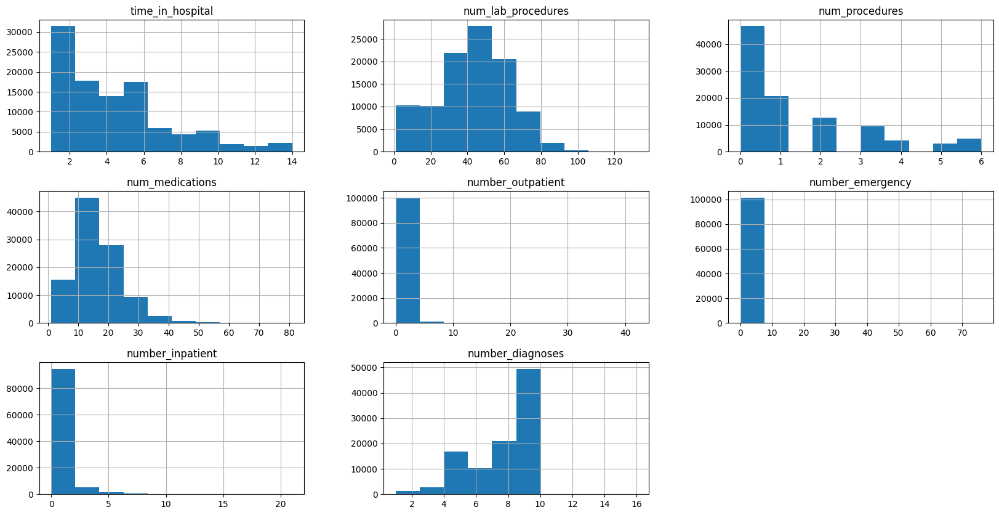

In [ ]:
new_df[numerical].hist(figsize=(20,10));

All are right skew except for number_diagnoses and num_lab_procedures. number_diagnoses and num_lab_procedures are left skew.  Data are not equally distributed.

#Categorical Features
categorical = ['race', 'gender', 'age', 'max_glu_serum', 'A1Cresult', 'metformin', 'repaglinide', 'nateglinide', 'chlorpropamide', 'glimepiride', 'acetohexamide', 'glipizide', 'glyburide', 'tolbutamide', 'pioglitazone', 'rosiglitazone', 'acarbose', 'miglitol', 'troglitazone', 'tolazamide', 'examide', 'citoglipton', 'insulin', 'glyburide-metformin', 'glipizide-metformin', 'glimepiride-pioglitazone', 'metformin-rosiglitazone','metformin-pioglitazone', 'change', 'diabetesMed', 'readmitted']


Race

In [ ]:
print (f'{round(new_df["race"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="race", title='Race', width=500, height=500)
fig.show()

Caucasian          76.49
AfricanAmerican    19.31
Hispanic            2.05
Other               1.51
Asian               0.64
Name: race, dtype: float64


The data indicate that Caucasians (76.5% of patients) are most affected by diabetes and then African American (19.31% of patients). Asians (0.64% of patients) are the least affected by diabetes.




Gender

In [ ]:
print (f'{round(new_df["gender"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="gender", title='Gender', width=500, height=500)
fig.show()

Female             53.76
Male               46.24
Unknown/Invalid     0.00
Name: gender, dtype: float64


Diabetes affected females (53.8% of patients) more than men (46.24% of patients). The difference between females and males is small.

Age

In [ ]:
print (f'{round(new_df["age"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="age", title='Age', width=500, height=500)
fig.show()

[70-80)     25.62
[60-70)     22.09
[50-60)     16.96
[80-90)     16.90
[40-50)      9.52
[30-40)      3.71
[90-100)     2.74
[20-30)      1.63
[10-20)      0.68
[0-10)       0.16
Name: age, dtype: float64


Diabetes largely affects individuals between the ages of 70-80 years old and then 60-70 years old.

In [ ]:
print (f'{round(new_df["max_glu_serum"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x='max_glu_serum', title='max_glu_serum', width=500, height=500)
fig.show()

None    94.75
Norm     2.55
>200     1.46
>300     1.24
Name: max_glu_serum, dtype: float64


Glucose serum is not measured in 94.75% of patients. When measured 2.55% of patients have normal levels, 1.46% are greater than 200 and 1.46% are greater than 300.

A1Cresult

In [ ]:
print (f'{round(new_df["A1Cresult"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="A1Cresult", title='A1Cresult', width=500, height=500)
fig.show()

None    83.28
>8       8.07
Norm     4.90
>7       3.75
Name: A1Cresult, dtype: float64


A1C is not usually measured. When measured 4.9% of patients have normal levels, 3.75% are greater than 7 and 8% are greater than 8.

Change in Medication

In [ ]:
print (f'{round(new_df["change"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="change", title='change', width=500, height=500)
fig.show()

No    53.8
Ch    46.2
Name: change, dtype: float64


There is mostly no change in diabetic medications. There is a change in diabetic medications for 46% of patients and no change for 53.8% of patients.

#Diabetes Medication Type

In [ ]:
print (f'{round(new_df["insulin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="insulin", title='insulin', width=500, height=500)
fig.show()

No        46.56
Steady    30.31
Down      12.01
Up        11.12
Name: insulin, dtype: float64


There's a large count of not prescribing insulin to treat diabetes. Once prescribed the dosages mostly remain steady. There's a decrease in dosage of 12.01% during the encounter and an increase in dosage of 11.2% during the encounter.

In [ ]:
print (f'{round(new_df["metformin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="metformin", title='metformin', width=500, height=500)
fig.show()

No        80.36
Steady    18.03
Up         1.05
Down       0.57
Name: metformin, dtype: float64


There's a large count of not prescribing metformin to treat diabetes. Once prescribed the dosages mostly remain steady.

In [ ]:
print (f'{round(new_df["repaglinide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="repaglinide", title='repaglinide', width=500, height=500)
fig.show()

No        98.49
Steady     1.36
Up         0.11
Down       0.04
Name: repaglinide, dtype: float64


There's a large count of not prescribing repaglinide to treat diabetes. Once prescribed the dosages mostly remain steady.

In [ ]:
print (f'{round(new_df["chlorpropamide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="chlorpropamide", title='chlorpropamide', width=500, height=500)
fig.show()

No        99.92
Steady     0.08
Up         0.01
Down       0.00
Name: chlorpropamide, dtype: float64


There's a large count of not prescribing chlorpropamide to treat diabetes. Once prescribed the dosages mostly remain steady at 0.08% and an increase in dossage of 0.01% of encounter.

In [ ]:
print (f'{round(new_df["acetohexamide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="acetohexamide", title='acetohexamide', width=500, height=500)
fig.show()

No        100.0
Steady      0.0
Name: acetohexamide, dtype: float64


 Acetohexamide has not been prescribed to treat diabetes.

In [ ]:
print (f'{round(new_df["nateglinide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="nateglinide", title='nateglinide', width=500, height=500)
fig.show()

No        99.31
Steady     0.66
Up         0.02
Down       0.01
Name: nateglinide, dtype: float64


In [ ]:
print (f'{round(new_df["glimepiride"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="glimepiride", title='glimepiride', width=500, height=500)
fig.show()

No        94.90
Steady     4.59
Up         0.32
Down       0.19
Name: glimepiride, dtype: float64


In [ ]:
print (f'{round(new_df["glipizide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="glipizide", title='glipizide', width=500, height=500)
fig.show()

No        87.53
Steady    11.16
Up         0.76
Down       0.55
Name: glipizide, dtype: float64


In [ ]:
print (f'{round(new_df["glyburide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="glyburide", title='glyburide', width=500, height=500)
fig.show()

No        89.53
Steady     9.11
Up         0.80
Down       0.55
Name: glyburide, dtype: float64


In [ ]:
print (f'{round(new_df["tolbutamide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="tolbutamide", title='tolbutamide', width=500, height=500)
fig.show()

No        99.98
Steady     0.02
Name: tolbutamide, dtype: float64


In [ ]:
print (f'{round(new_df["pioglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="pioglitazone", title='pioglitazone', width=500, height=500)
fig.show()

No        92.80
Steady     6.85
Up         0.23
Down       0.12
Name: pioglitazone, dtype: float64


In [ ]:
print (f'{round(new_df["rosiglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="rosiglitazone", title='rosiglitazone', width=500, height=500)
fig.show()

No        93.75
Steady     5.99
Up         0.17
Down       0.09
Name: rosiglitazone, dtype: float64


In [ ]:
print (f'{round(new_df["acarbose"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="acarbose", title='acarbose', width=500, height=500)
fig.show()

No        99.70
Steady     0.29
Up         0.01
Down       0.00
Name: acarbose, dtype: float64


In [ ]:
print (f'{round(new_df["miglitol"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="miglitol", title='miglitol', width=500, height=500)
fig.show()

No        99.96
Steady     0.03
Down       0.00
Up         0.00
Name: miglitol, dtype: float64


In [ ]:
print (f'{round(new_df["troglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="troglitazone", title='troglitazone', width=500, height=500)
fig.show()

No        100.0
Steady      0.0
Name: troglitazone, dtype: float64


In [ ]:
print (f'{round(new_df["tolazamide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="tolazamide", title='tolazamide', width=500, height=500)
fig.show()

No        99.96
Steady     0.04
Up         0.00
Name: tolazamide, dtype: float64


In [ ]:
print (f'{round(new_df["examide"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="examide", title='examide', width=500, height=500)
fig.show()

No    100.0
Name: examide, dtype: float64


In [ ]:
print (f'{round(new_df["citoglipton"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="citoglipton", title='citoglipton', width=500, height=500)
fig.show()

No    100.0
Name: citoglipton, dtype: float64


In [ ]:
print (f'{round(new_df["glyburide-metformin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="glyburide-metformin", title='glyburide-metformin', width=500, height=500)
fig.show()

No        99.31
Steady     0.68
Up         0.01
Down       0.01
Name: glyburide-metformin, dtype: float64


In [ ]:
print (f'{round(new_df["glipizide-metformin"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="glipizide-metformin", title='glipizide-metformin', width=500, height=500)
fig.show()

No        99.99
Steady     0.01
Name: glipizide-metformin, dtype: float64


In [ ]:
print (f'{round(new_df["glimepiride-pioglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="glimepiride-pioglitazone", title='glimepiride-pioglitazone', width=500, height=500)
fig.show()

No        100.0
Steady      0.0
Name: glimepiride-pioglitazone, dtype: float64


In [ ]:
print (f'{round(new_df["metformin-rosiglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="metformin-rosiglitazone", title='metformin-rosiglitazone', width=500, height=500)
fig.show()

No        100.0
Steady      0.0
Name: metformin-rosiglitazone, dtype: float64


In [ ]:
print (f'{round(new_df["metformin-pioglitazone"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="metformin-pioglitazone", title='metformin-pioglitazone', width=500, height=500)
fig.show()

No        100.0
Steady      0.0
Name: metformin-pioglitazone, dtype: float64


##Diabetes medication type insights
For most diabetes medications, once prescribed the dosage remains steady and few encounters resulted in an increase or decrease in dosage. The drugs that was most prescribed to treat diabetes are insulin and metformin. The data indicates that 46.56% of patients were not prescribed insulin and 80.36% of patients were not prescribed metformin.
The types of drugs that have not been prescribed are acetohexamide, troglitazone, examide, citoglipton, glimepiride-pioglitazone, and metformin-rosiglitazone, metformin-pioglitazone because the bar graph indicates that 100% of patients were not prescribed the drug.

Diabetes Medication

In [ ]:
print (f'{round(new_df["diabetesMed"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="diabetesMed", title='Diabetes Medication', width=500, height=500)
fig.show()

Yes    77.0
No     23.0
Name: diabetesMed, dtype: float64


Most individuals with diabetes are prescribed diabetes medication. 77% of patients are prescribed diabetes medication and 23% of patients are not prescribed diabetes medication.

Readmitted

In [ ]:
print (f'{round(new_df["readmitted"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="readmitted", title='Readmitted', width=500, height=500)
fig.show()

NO     53.91
>30    34.93
<30    11.16
Name: readmitted, dtype: float64


There's 54.86k (54%) of patients not readmitted and 35.55k (35%) of patients readmitted in greater than 30 days and 11.36k (11%) of patients readmitted less than 30 days.

In [ ]:
print (f'{round(new_df["time_in_hospital"].value_counts(normalize=True)*100,2)}')
fig = px.histogram(new_df, x="time_in_hospital", title='time_in_hospital', width=500, height=500)
fig.show()

3     17.45
2     16.93
1     13.96
4     13.68
5      9.79
6      7.41
7      5.76
8      4.31
9      2.95
10     2.30
11     1.82
12     1.42
13     1.19
14     1.02
Name: time_in_hospital, dtype: float64


Most length of stay in the hospital is 3 days and the next highest number of stay is 2 days.

# Bivariate Analysis

Converting readmitted values to binary values of 0's and 1's.

In [ ]:
diabetes["readmitted"].unique()

array(['NO', '>30', '<30'], dtype=object)

In [ ]:
# Replacing values
diabetes["readmitted"] = diabetes["readmitted"].replace({"NO": 0, "<30": 1, ">30": 0})

In [ ]:
diabetes["readmitted"].value_counts()

0    90409
1    11357
Name: readmitted, dtype: int64

Race and Readmission

In [ ]:
print (f'A person with Caucasian race has a probability of {round(diabetes[diabetes["race"]=="Caucasian"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person with African American race has a probability of {round(diabetes[diabetes["race"]=="AfricanAmerican"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person with Hispanic race has a probability of {round(diabetes[diabetes["race"]=="Hispanic"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person with Asian race has a probability of {round(diabetes[diabetes["race"]=="Asian"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person with Other race has a probability of {round(diabetes[diabetes["race"]=="Other"]["readmitted"].mean()*100,2)} % to be readmitted')

A person with Caucasian race has a probability of 11.29 % to be readmitted

A person with African American race has a probability of 11.22 % to be readmitted

A person with Hispanic race has a probability of 10.41 % to be readmitted

A person with Asian race has a probability of 10.14 % to be readmitted

A person with Other race has a probability of 9.63 % to be readmitted


In [ ]:
fig = px.histogram(diabetes, x="race", color="readmitted",width=600, height=600)
fig.show()

Gender and Readmission

In [ ]:
print (f'A person with Male gender has a probability of {round(diabetes[diabetes["gender"]=="Male"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person with Female gender has a probability of {round(diabetes[diabetes["gender"]=="Female"]["readmitted"].mean()*100,2)} % to be readmitted')

A person with Male gender has a probability of 11.06 % to be readmitted

A person with Female gender has a probability of 11.25 % to be readmitted


In [ ]:
fig = px.histogram(diabetes, x="gender", color="readmitted",width=600, height=600)
fig.show()

Age and Readmission

In [ ]:
print (f'A person [70-80) has a probability of {round(diabetes[diabetes["age"]=="[70-80)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [60-70) has a probability of {round(diabetes[diabetes["age"]=="[60-70)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [80-90) has a probability of {round(diabetes[diabetes["age"]=="[80-90)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [50-60) has a probability of {round(diabetes[diabetes["age"]=="[50-60)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [40-50) has a probability of {round(diabetes[diabetes["age"]=="[40-50)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [30-40) has a probability of {round(diabetes[diabetes["age"]=="[30-40)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [90-100) has a probability of {round(diabetes[diabetes["age"]=="[90-100)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [20-30) has a probability of {round(diabetes[diabetes["age"]=="[20-30)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [10-20) has a probability of {round(diabetes[diabetes["age"]=="[10-20)"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person [0-10) has a probability of {round(diabetes[diabetes["age"]=="[0-10)"]["readmitted"].mean()*100,2)} % to be readmitted')

A person [70-80) has a probability of 11.77 % to be readmitted

A person [60-70) has a probability of 11.13 % to be readmitted

A person [80-90) has a probability of 12.08 % to be readmitted

A person [50-60) has a probability of 9.67 % to be readmitted

A person [40-50) has a probability of 10.6 % to be readmitted

A person [30-40) has a probability of 11.23 % to be readmitted

A person [90-100) has a probability of 11.1 % to be readmitted

A person [20-30) has a probability of 14.24 % to be readmitted

A person [10-20) has a probability of 5.79 % to be readmitted

A person [0-10) has a probability of 1.86 % to be readmitted


In [ ]:
fig = px.histogram(diabetes, x="age", color="readmitted",width=600, height=600)
fig.show()

A1C Results and Readmission

In [ ]:
print (f'A person with None A1C result has a probability of {round(diabetes[diabetes["A1Cresult"]=="None"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person with >8 A1C result has a probability of {round(diabetes[diabetes["A1Cresult"]==">8"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person with Norm A1C result has a probability of {round(diabetes[diabetes["A1Cresult"]=="Norm"]["readmitted"].mean()*100,2)} % to be readmitted')

print()

print (f'A person with >7 A1C result has a probability of {round(diabetes[diabetes["A1Cresult"]==">7"]["readmitted"].mean()*100,2)} % to be readmitted')


A person with None A1C result has a probability of 11.42 % to be readmitted

A person with >8 A1C result has a probability of 9.87 % to be readmitted

A person with Norm A1C result has a probability of 9.66 % to be readmitted

A person with >7 A1C result has a probability of 10.05 % to be readmitted


In [ ]:
fig = px.histogram(diabetes, x="A1Cresult", color="readmitted",width=600, height=600)
fig.show()

#Metrics of Importance

In [ ]:
from sklearn.metrics import mutual_info_score
def cat_mut_inf(series):
    return mutual_info_score(series, diabetes['readmitted'])

diabetes_cat = diabetes[categorical].apply(cat_mut_inf)
diabetes_cat = diabetes_cat.sort_values(ascending=False).to_frame(name='mutual_info_score')
diabetes_cat

,mutual_info_score
readmitted,3.498458e-01
insulin,9.096770e-04
age,6.246920e-04
diabetesMed,3.793263e-04
metformin,2.998076e-04
change,1.898623e-04
A1Cresult,1.811281e-04
race,1.364375e-04
max_glu_serum,7.265894e-05
repaglinide,5.470242e-05


#Correlation Matrix & Scatter Plots

In [ ]:
diabetes[numerical].corr()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
time_in_hospital,1.000000,0.318450,0.191472,0.466135,-0.008916,-0.009681,0.073623,0.220186
num_lab_procedures,0.318450,1.000000,0.058066,0.268161,-0.007602,-0.002279,0.039231,0.152773
num_procedures,0.191472,0.058066,1.000000,0.385767,-0.024819,-0.038179,-0.066236,0.073734
num_medications,0.466135,0.268161,0.385767,1.000000,0.045197,0.013180,0.064194,0.261526
number_outpatient,-0.008916,-0.007602,-0.024819,0.045197,1.000000,0.091459,0.107338,0.094152
number_emergency,-0.009681,-0.002279,-0.038179,0.013180,0.091459,1.000000,0.266559,0.055539
number_inpatient,0.073623,0.039231,-0.066236,0.064194,0.107338,0.266559,1.000000,0.104710
number_diagnoses,0.220186,0.152773,0.073734,0.261526,0.094152,0.055539,0.104710,1.000000


In [ ]:
diabetes.groupby('readmitted')[numerical].mean()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
readmitted,,,,,,,,
0,4.349224,42.953644,1.347123,15.911137,0.360871,0.177803,0.561648,7.388667
1,4.768249,44.226028,1.280884,16.903143,0.436911,0.357313,1.224003,7.692789


In [ ]:
numerical = ['time_in_hospital','num_lab_procedures', 'num_procedures','num_medications', 'number_outpatient', 'number_emergency', 'number_inpatient', 'number_diagnoses']
diabetes[numerical].corr()

,time_in_hospital,num_lab_procedures,num_procedures,num_medications,number_outpatient,number_emergency,number_inpatient,number_diagnoses
time_in_hospital,1.000000,0.318450,0.191472,0.466135,-0.008916,-0.009681,0.073623,0.220186
num_lab_procedures,0.318450,1.000000,0.058066,0.268161,-0.007602,-0.002279,0.039231,0.152773
num_procedures,0.191472,0.058066,1.000000,0.385767,-0.024819,-0.038179,-0.066236,0.073734
num_medications,0.466135,0.268161,0.385767,1.000000,0.045197,0.013180,0.064194,0.261526
number_outpatient,-0.008916,-0.007602,-0.024819,0.045197,1.000000,0.091459,0.107338,0.094152
number_emergency,-0.009681,-0.002279,-0.038179,0.013180,0.091459,1.000000,0.266559,0.055539
number_inpatient,0.073623,0.039231,-0.066236,0.064194,0.107338,0.266559,1.000000,0.104710
number_diagnoses,0.220186,0.152773,0.073734,0.261526,0.094152,0.055539,0.104710,1.000000


In [ ]:
fig = px.scatter(diabetes, x='time_in_hospital', y='num_lab_procedures', title='Time in Hospital vs Num Lab Procedures')
fig.show()

In [ ]:
fig = px.scatter(diabetes, x='time_in_hospital', y='num_medications', title='Time in Hospitals vs Num of Medication')
fig.show()

In [ ]:
fig = px.scatter(diabetes, x='time_in_hospital', y='number_outpatient', title='Time in Hospital vs Num Outpatient')
fig.show()

In [ ]:
fig = px.scatter(diabetes, x='time_in_hospital', y='number_emergency', title='Time in Hospital vs Num Emergency')
fig.show()

## Converting Categorical Features into

---

Numeric Features

---



In [ ]:
# Using get_dummies from the pandas library to convert categorical feature to numeric
diabetes_df = pd.get_dummies(new_df, drop_first = False)

In [ ]:
diabetes_df.head(10)

# Breaking the data up into Train & Test